# Capstone Project - The Battle of the Neighborhoods 
### Applied Data Science Capstone by IBM/Coursera

## Table of contents
* [1- Introduction: Business Problem](#introduction)
* [2- Data](#data)
* [3- Explatory Data Analysis](#eda)
* [4- Clustering Analysis](#cluster)
* [5- Results and Discussion](#results)
* [6- Conclusion](#conclusion)


## 1- Introduction/Problem <a name="introduction"></a>

Moving to a new city is exciting but at the same time can be a little bit of scary. Depending on the family size, age, style of living, etc. considerations and priorities differ when choosing the best neighborhood to live.

It takes a lot of planning especially for a family with kids to find the best neighborhood to live. Moving is expensive, thus you want to minimize the likelihood of having to move to another neighborhood after your first move to the city.

There are websites that list best neighborhoods in cities, however these are not sufficient in making decisions and don’t allow one to weigh each neighborhood based on specific preferences.

In this project, we’ll use our data science powers to help a family moving to Chicago to locate the best neighborhoods that match their priorities/preferences. Here are the considerations of this family:
-	Neighborhood safety (crime rates)
-	School (K-12) rankings
-	Proximity to venues such as parks, martial art schools, and music schools
-	Housing prices
-	Proximity to new job location (which is Downtown Chicago)

After gathering all necessary and up-to-date data, we’ll cluster the neighborhoods and provide a list of options to the family based on their interests.





## 2- Data <a name="data"></a>

Chicago is one of the largest metropolises in the United States with a population of 2.706 million as of 2018. It has more than 200 neighborhoods and 77 community areas. Community areas are used for city-wide statistical and planning purposes. As most data we need is available at the community area level, we’ll perform our analysis at the community area level.
There are six main sources of data we’ll use in our project:
-	Wikipedia
-	Chicago Data Portal 
-	Zillow Housing Data
-	Foursquare API 
-   Microsoft Bing Maps Distance API
-   geopy.geocoder

One of the first things I learnt about data science is that a data scientist spends about 80% of his/her time on ETL (extraction, transformation, and loading). Identifying the data sources and gathering data from different sources formed the major part of this project.

The Data section consists of the following subsections:
1. Geographic boundaries of Chicago community areas
2. Wikipedia data on population and population density of community areas
3. Wikipedia data for community area - neighborhood relation
4. Extracting latitude and longitude information for community areas
5. Crime Data
6. Zillow Housing Data 
7. School Data
8. Foursquare API Data 
9. Driving distance to Downtown Chicago


Each section has information on how data was cleaned and features were extracted. At the end of the data section, we'll have our pandas dataframe named chicago_data that has all the relevant data.

**Let's import the neccesary libraries first**

In [123]:
import pandas as pd
import numpy as np
import json
import folium
from geopy.geocoders import Nominatim 
from sodapy import Socrata # for some datasets in Chicago Data Portal

# To determine if a point is in a polygon--used for determining the community areas for schools 
from shapely.geometry import shape, Point

import requests

from statistics import median
import matplotlib.pyplot as plt
import seaborn as sns
sns.set()

#for clustering
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from sklearn import metrics 
from scipy.spatial.distance import cdist 
from sklearn.preprocessing import StandardScaler, MinMaxScaler



### 1- Geographic boundaries of Chicago community areas

We downloaded the geojson file for community boundaries from the Chicago Data Portal.

In [2]:
#https://data.cityofchicago.org/Facilities-Geographic-Boundaries/Boundaries-Community-Areas-current-/cauq-8yn6
with open('Boundaries_Chicago.geojson') as json_data:
    c_data = json.load(json_data) 
print('There are {} community areas in Chicago'.format(len(c_data['features'])))

There are 77 community areas in Chicago


Let's write a function that determines the community area for a given location (latitude, longitude). We'll use this function with school data to identify the community areas that schools belong to.

In [3]:
def find_community_area(latitude, longitude):
    point= Point(longitude,latitude)
    for feature in c_data['features']:
        polygon = shape(feature['geometry'])
        if polygon.contains(point):
            return feature['properties']['area_numbe']
    return 0
    

### 2- Wikipedia data on population and population density of community areas

Let's scrape data from Wikipedia. Our first Wikipedia url gives us a table of community areas, community numbers, area, population (2017) and density.

In [5]:
wiki_url="https://en.wikipedia.org/wiki/Community_areas_in_Chicago#cite_note-City_basics-9"
community_data= pd.read_html(wiki_url)[0]
community_data.head()

,Number[8],Name[8],2017[9],Area (sq mi.)[10],Area (km2),2017density (/sq mi.),2017density (/km2)
0,01,Rogers Park,55062,1.84,4.77,29925.00,11554.11
1,02,West Ridge,76215,3.53,9.14,21590.65,8336.20
2,03,Uptown,57973,2.32,6.01,24988.36,9648.06
3,04,Lincoln Square,41715,2.56,6.63,16294.92,6291.50
4,05,North Center,35789,2.05,5.31,17458.05,6740.59


#### Data Cleaning
Let's rename columns, only use miles as units for population density, and remove area columns.

In [6]:
community_data.drop(['Area (km2)', '2017density (/km2)','Area (sq mi.)[10]'], inplace=True, axis=1)
community_data.rename(columns={'Number[8]':'Community_Number','Name[8]':'Community_Name', '2017[9]':'2017_Population','2017density (/sq mi.)': '2017_Population_Density'}, inplace=True)
#We need to make community area names upper case in order to match the geojson file to generate a choropleth map
community_data['Community_Name'] = community_data['Community_Name'].str.upper() 
community_data.head()

,Community_Number,Community_Name,2017_Population,2017_Population_Density
0,01,ROGERS PARK,55062,29925.00
1,02,WEST RIDGE,76215,21590.65
2,03,UPTOWN,57973,24988.36
3,04,LINCOLN SQUARE,41715,16294.92
4,05,NORTH CENTER,35789,17458.05


There's a formatting error in the Community_Name column in row 31. Let's fix it.

In [7]:
community_data.loc[31,'Community_Name']='LOOP'

Let's delete the very last row of the data frame that displays the total:


In [8]:
community_data.drop(community_data.index[-1], inplace=True)

In [9]:
community_data.dtypes

Community_Number            object
Community_Name              object
2017_Population              int64
2017_Population_Density    float64
dtype: object

**Let's change the data type of Community_Number to integer:**

In [10]:
community_data['Community_Number']=community_data['Community_Number'].astype(int)
community_data.dtypes

Community_Number             int64
Community_Name              object
2017_Population              int64
2017_Population_Density    float64
dtype: object

**Let's create a dictionary to map community area names to community area numbers.** The to_dict() function uses the index column as the key. We will set index to Community_Name first, and then create our dictionary.

In [11]:
comm_name_to_num=community_data.set_index('Community_Name')[[ 'Community_Number']].to_dict()['Community_Number']
comm_name_to_num['ROGERS PARK']

1

In [12]:
community_data.head()

,Community_Number,Community_Name,2017_Population,2017_Population_Density
0,1,ROGERS PARK,55062,29925.00
1,2,WEST RIDGE,76215,21590.65
2,3,UPTOWN,57973,24988.36
3,4,LINCOLN SQUARE,41715,16294.92
4,5,NORTH CENTER,35789,17458.05


### 3- Wikipedia data for community area - neighborhood relation

There is no dataset in the Chicago Data Portal showing the community area-neighborhood relation. We'll get this data from Wikipedia. Wikipedia list has 246 Chicago neighborhoods. Some neighborhoods are within boundaries of more than one community area. Different sources list different number of neighborhoods. For instance, Zillow Housing Dataset has 200 Chicago neighborhoods.

In [13]:
wiki_url2='https://en.wikipedia.org/wiki/List_of_neighborhoods_in_Chicago#cite_note-1'
comm_neigh= pd.read_html(wiki_url2)[0]
comm_neigh.rename(columns={'Community area': 'Community_Name'}, inplace=True)
comm_neigh.head()

,Neighborhood,Community_Name
0,Albany Park,Albany Park
1,Altgeld Gardens,Riverdale
2,Andersonville,Edgewater
3,Archer Heights,Archer Heights
4,Armour Square,Armour Square


In [14]:
print('There are {} neighborhoods listed in this page'.format(comm_neigh.shape[0]))

There are 246 neighborhoods listed in this page


#### Data Cleaning:

- For consistency with the comm_name_to_num dictionary and the geojson file, let's capitalize the community area names.
- Some neighborhoods are associated with more than one community area separated by a comma. Let's separate them and create new rows for the data frame so that each row has one pair of neighborhood and community area.
- Let's create dictionaries mapping neighborhoods to community areas, and community areas to neighborhoods. This will be useful later on in our analysis especially when using Zillow housing data on neighborhoods.

In [15]:
comm_neigh['Community_Name']=comm_neigh['Community_Name'].str.upper() 

In [16]:
# Let's identify the rows we need to edit
index=comm_neigh[comm_neigh['Community_Name'].str.contains(',')].index
comm_neigh.loc[index]

,Neighborhood,Community_Name
167,Polish Downtown,"WEST TOWN, LOGAN SQUARE"
168,Polish Village,"AVONDALE, IRVING PARK"
225,West Chesterfield,"CHATHAM, ROSELAND"
230,West Humboldt Park,"AUSTIN, HUMBOLDT PARK"


In [17]:
#let's edit these rows by creating a new row for each Community_Name
row=[]
for i in index:
    cl=comm_neigh.loc[i,'Community_Name'].split(',')
    comm_neigh.loc[i,'Community_Name']=cl[0].strip()
    row.append([comm_neigh.loc[i,'Neighborhood'],cl[-1].strip()])

df=pd.DataFrame(row,columns=comm_neigh.columns)
comm_neigh=pd.concat([comm_neigh, df],ignore_index=True)
comm_neigh.tail()
  

,Neighborhood,Community_Name
245,Wrigleyville,LAKE VIEW
246,Polish Downtown,LOGAN SQUARE
247,Polish Village,IRVING PARK
248,West Chesterfield,ROSELAND
249,West Humboldt Park,HUMBOLDT PARK


**Let's verify that we have 77 community area names:**

In [18]:
print('There are {} community areas in this data frame!'.format(comm_neigh['Community_Name'].nunique()))

There are 78 community areas in this data frame!


Some exploration of the data revealed that the community area 'LAKE VIEW' is written both as 'LAKE VIEW' and 'LAKEVIEW'. To be consistent, we'll change 'LAKEVIEW' to 'LAKE VIEW'

In [19]:
# It appears that there is only one row we need to edit.
index=comm_neigh[comm_neigh['Community_Name']=='LAKEVIEW'].index
print('Row to edit is at index={}'.format(index[0]))
comm_neigh.loc[index[0], 'Community_Name']='LAKE VIEW'
print('After this edit, we have {} community area names in this dataframe'.format(comm_neigh['Community_Name'].nunique()))

    

Row to edit is at index=196
After this edit, we have 77 community area names in this dataframe


In [20]:
index=comm_neigh[comm_neigh['Community_Name']=='THE LOOP'].index
comm_neigh.loc[index,['Community_Name']]='LOOP'


**Let's create a dictionary to map neighborhoods to their community areas.** There are 4 neighborhoods that belong to 2 community areas.

In [20]:
community_dict=comm_neigh.groupby('Neighborhood')['Community_Name'].apply(list).to_dict()
community_dict

{'Albany Park': ['ALBANY PARK'],
 'Altgeld Gardens': ['RIVERDALE'],
 'Andersonville': ['EDGEWATER'],
 'Archer Heights': ['ARCHER HEIGHTS'],
 'Armour Square': ['ARMOUR SQUARE'],
 'Ashburn': ['ASHBURN'],
 'Ashburn Estates': ['ASHBURN'],
 'Auburn Gresham': ['AUBURN GRESHAM'],
 'Avalon Park': ['AVALON PARK'],
 'Avondale': ['AVONDALE'],
 'Avondale Gardens': ['IRVING PARK'],
 'Back of the Yards': ['NEW CITY'],
 'Belmont Central': ['BELMONT CRAGIN'],
 'Belmont Gardens': ['HERMOSA'],
 'Belmont Heights': ['DUNNING'],
 'Belmont Terrace': ['DUNNING'],
 'Beverly': ['BEVERLY'],
 'Beverly View': ['ASHBURN'],
 'Beverly Woods': ['MORGAN PARK'],
 'Big Oaks': ['NORWOOD PARK'],
 'Bowmanville': ['LINCOLN SQUARE'],
 'Boystown': ['LAKE VIEW'],
 'Brainerd': ['WASHINGTON HEIGHTS'],
 'Brickyard': ['BELMONT CRAGIN'],
 'Bridgeport': ['BRIDGEPORT'],
 'Brighton Park': ['BRIGHTON PARK'],
 'Bronzeville': ['DOUGLAS'],
 'Bucktown': ['LOGAN SQUARE'],
 'Budlong Woods': ['LINCOLN SQUARE'],
 'Buena Park': ['UPTOWN'],
 'Bu

**Let's create a dictionary to map community areas to their neighborhoods.** 

In [21]:
neighbor_dict=comm_neigh.groupby('Community_Name')['Neighborhood'].apply(list).to_dict()
neighbor_dict

{'ALBANY PARK': ['Albany Park',
  'Mayfair',
  'North Mayfair',
  'Ravenswood Manor'],
 'ARCHER HEIGHTS': ['Archer Heights'],
 'ARMOUR SQUARE': ['Armour Square', 'Chinatown', 'Wentworth Gardens'],
 'ASHBURN': ['Ashburn',
  'Ashburn Estates',
  'Beverly View',
  'Crestline',
  'Parkview',
  'Scottsdale',
  'Wrightwood'],
 'AUBURN GRESHAM': ['Auburn Gresham', 'Gresham'],
 'AUSTIN': ['Galewood',
  'The Island',
  'North Austin',
  'South Austin',
  'West Humboldt Park'],
 'AVALON PARK': ['Avalon Park', 'Marynook', 'Stony Island Park'],
 'AVONDALE': ['Avondale', 'Jackowo', 'Polish Village', 'Wacławowo'],
 'BELMONT CRAGIN': ['Belmont Central', 'Brickyard', 'Cragin', 'Hanson Park'],
 'BEVERLY': ['Beverly', 'East Beverly', 'West Beverly'],
 'BRIDGEPORT': ['Bridgeport'],
 'BRIGHTON PARK': ['Brighton Park'],
 'BURNSIDE': ['Burnside'],
 'CALUMET HEIGHTS': ['Calumet Heights', 'Pill Hill'],
 'CHATHAM': ['Chatham', 'East Chatham', 'West Chatham', 'West Chesterfield'],
 'CHICAGO LAWN': ['Chicago Law

When working with housing prices, none of the GRAND BOULEVARD neighborhoods were listed in Zillow. A further search on Google Maps revealed that Bronzeville is also a neighborhood in this community area.
source: https://www.google.com/maps/d/u/0/viewer?ll=41.78633811435371%2C-87.67244077799607&spn=0.340714%2C0.699692&msa=0&mid=1O-3Uot4mSetKW-M_govahruUjDc&z=16

Let's add it to our neighborhoods dictionary.

In [49]:
neighbor_dict['GRAND BOULEVARD'].append('Bronzeville')

### 4- Extracting latitude and longitude information for community areas

Let's find the latitudes and longitudes of the community areas for visualizations. We'll use geopy.geocoders. 


In [22]:
geolocator = Nominatim(user_agent="ch_explorer")
latitude=[]
longitude=[]
for address in community_data['Community_Name']:
    address=  address+' Chicago'
    #print(address)
    location = geolocator.geocode(address)
    latitude.append(location.latitude)
    longitude.append(location.longitude)
#Let's include the latitude longitude information in our data frame:
community_data['Latitude']=latitude
community_data['Longitude']=longitude
community_data.head()

,Community_Number,Community_Name,2017_Population,2017_Population_Density,Latitude,Longitude
0,1,ROGERS PARK,55062,29925.00,42.010531,-87.670748
1,2,WEST RIDGE,76215,21590.65,42.003548,-87.696243
2,3,UPTOWN,57973,24988.36,41.966630,-87.655546
3,4,LINCOLN SQUARE,41715,16294.92,41.975990,-87.689616
4,5,NORTH CENTER,35789,17458.05,41.956107,-87.679160


Based on the initial map generated, Lincoln Park and Greater Grand Crossing latitude-longitude information seems to be incorrect. Let's update these entries based on Google search:
Lincoln park: 41.9255° N, 87.6488° W 
Greater Grand Crossing: 41.7657° N, 87.6153° W

In [25]:
index=community_data[community_data['Community_Name']=='LINCOLN PARK'].index
community_data.loc[index,'Latitude']= 41.9255
community_data.loc[index,'Longitude']= -87.6488

In [26]:
index=community_data[community_data['Community_Name']=='GREATER GRAND CROSSING'].index
community_data.loc[index,'Latitude']= 41.7657
community_data.loc[index,'Longitude']= -87.6153

### 5- Crime Data

We'll get our crime data from  Chicago Data Portal. This data set displays the incidents of crime reported in Chicago from 2001 to present (minus the most recent 7 days).  In addition to details on the nature of the crime, this data set also reports the community area that the crime took place. 

https://data.cityofchicago.org/Public-Safety/Crimes-2001-to-Present/ijzp-q8t2/data

Since this is a huge dataset, we’ll use SODA API to filter results to focus on certain columns and years (2019 and 2020). To do so, we need to pass a query (SQL-like) to the Socrata client.
We'll get the date, primary_type, community_area and year columns for the years 2019 and 2020.

In this query, it is important to explicitly set limit to a large value. The default value is 1000, and if left as is, your query will only return 1000 of the rows that match your query.



**Let's get crime data, clean it, and write into a file.** We'll carry on our analysis using the file as new crimes will be added to this dataset on the portal.  



In [27]:
client = Socrata('data.cityofchicago.org',
                  'OTi3T3TI8nQNSuufXG5j6bZlv',
                  username="my_user_name",
                  password="my_password")


In [28]:
crimes = client.get("ijzp-q8t2", query='Select date, primary_type,community_area, year where year > 2018 limit 500000')
crimes_df = pd.DataFrame.from_records(crimes) 
crimes_df.head()


,date,primary_type,community_area,year
0,2019-12-03T13:08:00.000,BATTERY,66,2019
1,2019-07-22T00:01:00.000,DECEPTIVE PRACTICE,2,2019
2,2019-12-07T12:33:00.000,SEX OFFENSE,42,2019
3,2019-12-04T06:00:00.000,SEX OFFENSE,35,2019
4,2019-07-21T18:35:00.000,BATTERY,30,2019


In [29]:
crimes_df.shape

(447537, 4)

#### Data Cleaning
Let's rename primary_type as crime_type and do some cleaning.

In [30]:
crimes_df.rename(columns={'primary_type': 'crime'}, inplace=True)

# we'll replace CRIM SEXUAL ASSAULT with CRIMINAL SEXUAL ASSAULT as both appear in the data frame.
crimes_df['crime'].replace('CRIM SEXUAL ASSAULT','CRIMINAL SEXUAL ASSAULT', inplace=True  )

#there is a NON-CRIMINAL crime_type. Let's delete those rows
index_list=crimes_df[crimes_df['crime']=='NON-CRIMINAL'].index
crimes_df.drop(index_list, inplace=True)

crimes_df['crime'].value_counts()

THEFT                                99421
BATTERY                              87252
CRIMINAL DAMAGE                      49194
ASSAULT                              37151
DECEPTIVE PRACTICE                   31814
OTHER OFFENSE                        27902
NARCOTICS                            21498
MOTOR VEHICLE THEFT                  17648
BURGLARY                             17610
ROBBERY                              15018
WEAPONS VIOLATION                    13716
CRIMINAL TRESPASS                    10630
OFFENSE INVOLVING CHILDREN            3947
PUBLIC PEACE VIOLATION                2729
CRIMINAL SEXUAL ASSAULT               2631
INTERFERENCE WITH PUBLIC OFFICER      2149
SEX OFFENSE                           2132
HOMICIDE                              1212
PROSTITUTION                           949
ARSON                                  897
STALKING                               394
LIQUOR LAW VIOLATION                   367
CONCEALED CARRY LICENSE VIOLATION      354
INTIMIDATIO

Let's save this dataframe into a csv file and work with that file for our analyis as this data set is updated frequently.

In [31]:
crimes_df.to_csv('Chicago_crime_data_11_28',index=False)

In [32]:
crimes_df=pd.read_csv('Chicago_crime_data_11_28')
crimes_df.head()

,date,crime,community_area,year
0,2019-12-03T13:08:00.000,BATTERY,66,2019
1,2019-07-22T00:01:00.000,DECEPTIVE PRACTICE,2,2019
2,2019-12-07T12:33:00.000,SEX OFFENSE,42,2019
3,2019-12-04T06:00:00.000,SEX OFFENSE,35,2019
4,2019-07-21T18:35:00.000,BATTERY,30,2019


There is potential for a lot of exploratory analysis with crime data. For instance analyzing month-to-month differences of different crimes in different community areas, and the distribution of crime types across different community areas. However, for the purposes of our project, we'll look at the total number of crimes reported in the community area since the beginning of 2019.

**For the purposes of our study, we'll use the total number of crime incidents reported in each community area since the beginning of year 2019.** 

In [33]:
print('There are {} types of crimes listed'.format(crimes_df['crime'].nunique()))

There are 31 types of crimes listed


Let's drop date and year columns.

In [34]:
crimes_df.drop(['date','year'], inplace=True, axis=1)
crimes_df.head(1)

,crime,community_area
0,BATTERY,66


In [35]:
community_crime=crimes_df.groupby('community_area').count()
community_crime.reset_index(inplace=True)
community_crime.rename(columns={'community_area':'Community_Number','crime':'Number_of_Crimes'},inplace=True)
community_crime.head()

,Community_Number,Number_of_Crimes
0,1,6952
1,2,6187
2,3,5963
3,4,3458
4,5,2259


In [36]:
community_data.dtypes

Community_Number             int64
Community_Name              object
2017_Population              int64
2017_Population_Density    float64
Latitude                   float64
Longitude                  float64
dtype: object

**Let's merge this data frame with the community_data dataframe based on 'Community_Number' and name our new data farme as chicago_data**

In [37]:
chicago_data=pd.merge(community_data, community_crime, on='Community_Number')
chicago_data.head()

,Community_Number,Community_Name,2017_Population,2017_Population_Density,Latitude,Longitude,Number_of_Crimes
0,1,ROGERS PARK,55062,29925.00,42.010531,-87.670748,6952
1,2,WEST RIDGE,76215,21590.65,42.003548,-87.696243,6187
2,3,UPTOWN,57973,24988.36,41.966630,-87.655546,5963
3,4,LINCOLN SQUARE,41715,16294.92,41.975990,-87.689616,3458
4,5,NORTH CENTER,35789,17458.05,41.956107,-87.679160,2259


### 6- Zillow Housing Data

Zillow has time series data available for download:
https://www.zillow.com/research/data/
Among several datasets listed here, we will use **ZHVI Single-Family Homes Time Series data** at the neighborhood level.

ZVHI stands for Zillow Home Value Index. This data set displays typical value in dollars for all single-family homes in a given region. After downloading this data set, we’ll extract the entries for Chicago Neighborhoods. In Zillow dataset, there are 200 Chicago Neighborhoods


In [38]:
file="http://files.zillowstatic.com/research/public_v2/zhvi/Neighborhood_zhvi_uc_sfr_sm_sa_mon.csv"
zillow_data=pd.read_csv(file) 

In [39]:
zillow_data=zillow_data.loc[zillow_data['City'] == 'Chicago']
zillow_data.head()


,RegionID,SizeRank,RegionName,RegionType,StateName,State,City,Metro,CountyName,1996-01-31,...,2020-01-31,2020-02-29,2020-03-31,2020-04-30,2020-05-31,2020-06-30,2020-07-31,2020-08-31,2020-09-30,2020-10-31
53,269592,53,Logan Square,Neighborhood,IL,IL,Chicago,Chicago-Naperville-Elgin,Cook County,154086.0,...,499367.0,503470.0,508541.0,513503.0,516831.0,520610.0,525108.0,530116.0,536466.0,542723.0
88,403117,88,Little Village,Neighborhood,IL,IL,Chicago,Chicago-Naperville-Elgin,Cook County,NaN,...,173503.0,173270.0,173594.0,173476.0,175075.0,177939.0,181581.0,182660.0,183257.0,184240.0
105,403169,106,West Rogers Park,Neighborhood,IL,IL,Chicago,Chicago-Naperville-Elgin,Cook County,157304.0,...,364883.0,367482.0,370122.0,372114.0,373802.0,375213.0,378298.0,381042.0,385421.0,389635.0
142,403120,144,South Austin,Neighborhood,IL,IL,Chicago,Chicago-Naperville-Elgin,Cook County,NaN,...,178077.0,179646.0,181244.0,182633.0,184235.0,186681.0,190292.0,194385.0,199312.0,205639.0
152,269566,154,Albany Park,Neighborhood,IL,IL,Chicago,Chicago-Naperville-Elgin,Cook County,146045.0,...,372049.0,373105.0,373382.0,374396.0,375792.0,377530.0,380331.0,384254.0,390099.0,395389.0


#### Cleaning Housing Data


For the purposes of this project, we'll only use the ZVHI estimate of the very last month.
Analyzing the house price trends in different neighborhoods and incorporating it in the descision making process is left as future work.




In [40]:
zillow_data=zillow_data[['RegionName','2020-10-31']]
zillow_data.head(3)

,RegionName,2020-10-31
53,Logan Square,542723.0
88,Little Village,184240.0
105,West Rogers Park,389635.0


Let's rename columns:

In [41]:
zillow_data.rename(columns={'RegionName':'Neighborhood', '2020-10-31':'House_Price_$'}, inplace=True)
#chicago_zillow_data.set_index('Neighborhood',inplace=True)
zillow_data.head(3)

,Neighborhood,House_Price_$
53,Logan Square,542723.0
88,Little Village,184240.0
105,West Rogers Park,389635.0


**We'd like to estimate the house values within each community area.** 

For this purpose, we'll write a function that takes a community area name and returns the median house price of the neighborhoods matched with the community area.

One major issue we need to overcome is that the neighborhood names are not official, and thus may not match accross different sources. Wikipedia source lists 245 Chicago neighborhoods whereas Zillow lists 200 neighborhoods. 

In [42]:
a=set(comm_neigh['Neighborhood'].to_list())
b=set(zillow_data['Neighborhood'].to_list())
print('{} of the neighborhoods in Wikipedia source do not exist in the Zillow source.'.format(len(list(a-b))))
print('{} of the neighborhoods in Zillow source do not exist in the Wkipedia source.'.format(len(list(b-a))))

71 of the neighborhoods in Wikipedia source do not exist in the Zillow source.
25 of the neighborhoods in Zillow source do not exist in the Wkipedia source.


Since we are working on estimates, for each community area, we'll look up the house prices of community area neighborhoods that are listed in Zillow. 

**Let's first create a dictionary to map neighborhoods to house prices based on Zillow data:**

In [43]:
price_dict= zillow_data.set_index('Neighborhood').to_dict()['House_Price_$']
price_dict

{'Logan Square': 542723.0,
 'Little Village': 184240.0,
 'West Rogers Park': 389635.0,
 'South Austin': 205639.0,
 'Albany Park': 395389.0,
 'Uptown': 738394.0,
 'Lake View': 978092.0,
 'Rogers Park': 410840.0,
 'Gresham': 159790.0,
 'Brighton Park': 227531.0,
 'Jefferson Park': 356928.0,
 'Portage Park': 353911.0,
 'South Loop': 642945.0,
 'Humboldt Park': 340325.0,
 'Gage Park': 205777.0,
 'Bridgeport': 435536.0,
 'Edgewater': 602046.0,
 'Lake View East': 743908.0,
 'South Shore': 177973.0,
 'Cragin': 314327.0,
 'West Lawn': 234036.0,
 'Bronzeville': 357731.0,
 'Belmont Central': 295930.0,
 'Marquette Park': 195676.0,
 'Garfield Ridge': 279924.0,
 'Near North': 746202.0,
 'West Pullman': 117172.0,
 'South Chicago': 138913.0,
 'West Town': 782479.0,
 'West Englewood': 96297.0,
 'North Austin': 227845.0,
 'East Garfield Park': 193832.0,
 'Ravenswood': 789650.0,
 'East Side': 148944.0,
 'Hermosa': 287441.0,
 'North Center': 999158.0,
 'Roseland': 108869.0,
 'Streeterville': 809620.0,
 '

Let's write our function now. We'll use the neighbor_dict which maps community area names to neighborhoods based on Wikipedia data as well as the price_dict that maps neighborhoods to house prices.

If house price data exists in more than one neighborhood, we'd like to report the median. If none of the neighborhoods for a community area have house price data, our function returns None.

In [44]:
def community_house_price(community_name):
    prices=[]
    for n in neighbor_dict[community_name]:
        if n in price_dict.keys():
            prices.append(price_dict[n])
        
    if len(prices)>0:
        return median(prices)
    else:
        return None
    
        
        

Let's test our function:
The median house price in West Ridge community area is $\$429,336$.


In [45]:
community_house_price('WEST RIDGE')

429336.0

Now we can create a column for the median house price and then add it to our chicago_data dataframe.

In [52]:
col=chicago_data.apply(lambda row: community_house_price(row.Community_Name), axis='columns', result_type='expand')
chicago_data = pd.concat([chicago_data, col], axis='columns')
chicago_data.rename(columns={0:'Median_House_Price'},inplace=True)
chicago_data.head(3)

,Community_Number,Community_Name,2017_Population,2017_Population_Density,Latitude,Longitude,Number_of_Crimes,Median_House_Price
0,1,ROGERS PARK,55062,29925.00,42.010531,-87.670748,6952,410840.0
1,2,WEST RIDGE,76215,21590.65,42.003548,-87.696243,6187,429336.0
2,3,UPTOWN,57973,24988.36,41.966630,-87.655546,5963,738394.0


Let's check if we have house price data for all community areas:

In [53]:
index=chicago_data[chicago_data['Median_House_Price'].isna()].index
index

Int64Index([67], dtype='int64')

In [54]:
chicago_data.loc[index]

,Community_Number,Community_Name,2017_Population,2017_Population_Density,Latitude,Longitude,Number_of_Crimes,Median_House_Price
67,68,ENGLEWOOD,25075,8167.75,41.779756,-87.645884,10664,NaN


None of the neighborhoods in Englewood have house prices listed in Zillow. Let's try searching for this community area/neighborhood on Zillow website. https://www.zillow.com/englewood-chicago-il/home-values/ We'll use the value reported here which is $\$255,532$.

In [55]:
chicago_data.loc[index,'Median_House_Price']=255532
chicago_data.isna().sum()

Community_Number           0
Community_Name             0
2017_Population            0
2017_Population_Density    0
Latitude                   0
Longitude                  0
Number_of_Crimes           0
Median_House_Price         0
dtype: int64

Good, we do not have any missing values in our chicago_data dataframe so far.

### 7- School Data
Chicago Data Portal has several datasets available in the education category. Among these 'Chicago Public Schools - School Profile Information SY2021' lists schools including their school quality rating.



<img src="Chicago_SQR.png" width=800 height=800 />

Here's the url for this data set: https://data.cityofchicago.org/Education/Chicago-Public-Schools-School-Profile-Information-/83yd-jxxw

The relevant columns to our project are:

 Overall_Rating, Rating_Status, Rating_Statement, School_Latitude, School_Longitude
 
We want to gather data at the community area level. We need to determine which community areas the schools belong to. We will use the **find_community_area** function we wrote earlier. This function will return the community area number that a latitude-longitude pair belongs to.  



In [56]:
school_file='Chicago_Public_Schools_School_Profile_Information_SY2021.csv'
school_data= pd.read_csv(school_file)
#Let's remove all columns other than School_ID, Long_Name, Address, Zip, Overall_Rating, Rating_Status, Rating_Statement, Latitude, Longitude
school_data=school_data[[ 'Overall_Rating', 'Rating_Status', 'Rating_Statement', 'School_Latitude', 'School_Longitude']]
school_data.head()

,Overall_Rating,Rating_Status,Rating_Statement,School_Latitude,School_Longitude
0,Inability to Rate,GOOD STANDING,This school did not have enough data to receiv...,41.842533,-87.695261
1,Level 2+,NOT APPLICABLE,"This school received a Level 2+ rating, which ...",41.801762,-87.711025
2,Level 1,GOOD STANDING,"This school received a Level 1 rating, which i...",41.928841,-87.669528
3,Level 2+,NOT APPLICABLE,"This school received a Level 2+ rating, which ...",41.778130,-87.598114
4,Level 2,PROVISIONAL SUPPORT,"This school received a Level 2 rating, which i...",41.935634,-87.783515


In [57]:
school_data['Overall_Rating'].value_counts()

Level 1              196
Level 2+             154
Level 1+             148
Level 2              127
Inability to Rate     21
Level 3                8
Name: Overall_Rating, dtype: int64

**Let's assign numerical values to Overall_Rating categories:**
We'll define a dictionary (SQR_rank) mapping Overall Ratings to scores. We'll score them from 1 to 5, 5 being the best score (Level 1+).
There are 21 schools which were not rated because of not having enough data.
Looking at the Rating_Status of these schools, it looks reasonable to assign a score of 3 to these schools because of their good standing. Another reason is that 3 is the median of the scores and a typical approach for imputing.

In [58]:
index=school_data[school_data['Overall_Rating']=='Inability to Rate'].index
school_data.loc[index,'Rating_Status'].value_counts()

GOOD STANDING     19
NOT APPLICABLE     2
Name: Rating_Status, dtype: int64

In [59]:
SQR_rank={}
SQR_rank['Inability to Rate']=3
SQR_rank['Level 1+']=5
SQR_rank['Level 1']=4
SQR_rank['Level 2+']=3
SQR_rank['Level 2']=2
SQR_rank['Level 3']=1
    

**Let's find the community area of each school, and add a Community_Number column to our dataframe.** 

We are using the **find_community_area(latitude, longitude)** function.

In [62]:
applied_df = school_data.apply(lambda row: find_community_area(row.School_Latitude,row.School_Longitude), axis='columns', result_type='expand')
school_data = pd.concat([school_data, applied_df], axis='columns')
school_data.rename(columns={0:'Community_Number'}, inplace=True)
school_data.head()

,Overall_Rating,Rating_Status,Rating_Statement,School_Latitude,School_Longitude,Community_Number
0,Inability to Rate,GOOD STANDING,This school did not have enough data to receiv...,41.842533,-87.695261,30
1,Level 2+,NOT APPLICABLE,"This school received a Level 2+ rating, which ...",41.801762,-87.711025,63
2,Level 1,GOOD STANDING,"This school received a Level 1 rating, which i...",41.928841,-87.669528,7
3,Level 2+,NOT APPLICABLE,"This school received a Level 2+ rating, which ...",41.778130,-87.598114,42
4,Level 2,PROVISIONAL SUPPORT,"This school received a Level 2 rating, which i...",41.935634,-87.783515,19


Let's write our data into a file.

In [63]:
school_data.to_csv('Chicago_School_Data_with_Community_Areas', index=False)


**Let's create a column for numerical rating of the schools and name it as Overall_Score:**

In [64]:
scores_df = school_data.apply(lambda row: SQR_rank[row.Overall_Rating], axis='columns', result_type='expand')
school_data = pd.concat([school_data, scores_df], axis='columns')
school_data.rename(columns={0:'Overall_Score'}, inplace=True)
school_data.head()

,Overall_Rating,Rating_Status,Rating_Statement,School_Latitude,School_Longitude,Community_Number,Overall_Score
0,Inability to Rate,GOOD STANDING,This school did not have enough data to receiv...,41.842533,-87.695261,30,3
1,Level 2+,NOT APPLICABLE,"This school received a Level 2+ rating, which ...",41.801762,-87.711025,63,3
2,Level 1,GOOD STANDING,"This school received a Level 1 rating, which i...",41.928841,-87.669528,7,4
3,Level 2+,NOT APPLICABLE,"This school received a Level 2+ rating, which ...",41.778130,-87.598114,42,3
4,Level 2,PROVISIONAL SUPPORT,"This school received a Level 2 rating, which i...",41.935634,-87.783515,19,2


**Let's group by community areas, and calculate the median scool score for each community area.**

In [65]:
df=school_data[['Overall_Score', 'Community_Number']].groupby('Community_Number').median()
df.reset_index(inplace=True)
df.rename(columns={'Overall_Score':'Median_School_Score'}, inplace=True)
df.head()

,Community_Number,Median_School_Score
0,1,4.0
1,10,4.0
2,11,4.5
3,12,5.0
4,13,4.5


In [66]:
# Let's make sure the datatype is integer for the Community Number.
#This is necessary as we are using this column to merge with our main dataframe
df['Community_Number']= df['Community_Number'].astype(int)


**Let's merge this dataframe with the chicago_data dataframe:**

In [67]:
chicago_data=pd.merge(chicago_data, df, on='Community_Number')
chicago_data.head()

,Community_Number,Community_Name,2017_Population,2017_Population_Density,Latitude,Longitude,Number_of_Crimes,Median_House_Price,Median_School_Score
0,1,ROGERS PARK,55062,29925.00,42.010531,-87.670748,6952,410840.0,4.0
1,2,WEST RIDGE,76215,21590.65,42.003548,-87.696243,6187,429336.0,5.0
2,3,UPTOWN,57973,24988.36,41.966630,-87.655546,5963,738394.0,4.0
3,4,LINCOLN SQUARE,41715,16294.92,41.975990,-87.689616,3458,719352.0,5.0
4,5,NORTH CENTER,35789,17458.05,41.956107,-87.679160,2259,1032181.5,5.0


In [68]:
chicago_data['Median_School_Score'].value_counts()

3.0    25
4.0    24
5.0    12
3.5     8
2.0     4
4.5     4
Name: Median_School_Score, dtype: int64

### 8- Foursquare Data

For each community area, we'll determine:

- Number of parks within 1000m
- Number of music schools within 2000m
- Number of martial art schools within 2000m

We need to find the category id's for these venues:
https://developer.foursquare.com/docs/build-with-foursquare/categories/

Martial Arts Dojo: 4bf58dd8d48988d101941735


Park: 4bf58dd8d48988d163941735

Music School: 4f04b10d2fb6e1c99f3db0be







#### Foursquare Credentials

In [124]:

CLIENT_ID = 'my_client_id'
CLIENT_SECRET = 'my_client_secret'
VERSION = '20180605' # Foursquare API version
LIMIT = 100 # A default Foursquare API limit value

print('Your credentails:')
print('CLIENT_ID: ' + CLIENT_ID)
print('CLIENT_SECRET:' + CLIENT_SECRET)

Your credentails:
CLIENT_ID: my_client_id
CLIENT_SECRET:my_client_secret



Let's write a function that will return the number of parks within a radius of 1000m, martial arts dojo and music school within a radius of 2000m.


In [70]:
def getVenueCounts(number, latitudes, longitudes):
    Park_ID='4bf58dd8d48988d163941735' 
    Park_radius=1000
    Martial_ID='4bf58dd8d48988d101941735'
    radius=2000
    Music_ID='4f04b10d2fb6e1c99f3db0be'
    venue_count=[]
    for number, lat, lng in zip(number, latitudes, longitudes):

        # getting number of parks
        url = 'https://api.foursquare.com/v2/venues/search?categoryId={}&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}'.format(
            Park_ID,
            CLIENT_ID, 
            CLIENT_SECRET, 
            VERSION, 
            lat, 
            lng, 
            Park_radius, 
            LIMIT)
        
        results = requests.get(url).json()["response"]
        park_count=len(results['venues'])
        
        
        url = 'https://api.foursquare.com/v2/venues/search?categoryId={}&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}'.format(
            Martial_ID,
            CLIENT_ID, 
            CLIENT_SECRET, 
            VERSION, 
            lat, 
            lng, 
            radius, 
            LIMIT)
            
        results = requests.get(url).json()["response"]
        martial_count=len(results['venues'])
        
        url = 'https://api.foursquare.com/v2/venues/search?categoryId={}&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}'.format(
            Music_ID,
            CLIENT_ID, 
            CLIENT_SECRET, 
            VERSION, 
            lat, 
            lng, 
            radius, 
            LIMIT)
            
       
        results = requests.get(url).json()["response"]
        music_count=len(results['venues'])
        
        venue_count.append([number, park_count, martial_count, music_count])
        
    venue_count_df=pd.DataFrame(venue_count)
    venue_count_df.rename(columns={0:'Community_Number',1:'Num_of_Parks',2:'Num_of_Martial_Arts', 3:'Num_of_Music_School'},inplace=True)
    return(venue_count_df)

In [71]:
count_df=getVenueCounts(number=chicago_data['Community_Number'],
                                   latitudes=chicago_data['Latitude'],
                                   longitudes=chicago_data['Longitude']
                                  )
count_df

,Community_Number,Num_of_Parks,Num_of_Martial_Arts,Num_of_Music_School
0,1,19,4,1
1,2,9,1,1
2,3,33,6,4
3,4,11,14,4
4,5,10,23,6
...,...,...,...,...
72,73,4,4,0
73,74,4,3,1
74,75,5,2,0
75,76,0,0,0


In [72]:
count_df.to_csv('Community_Area_Venue_Counts.csv', index=False)

In [73]:
chicago_data=pd.merge(chicago_data, count_df, on='Community_Number')
chicago_data.head()

,Community_Number,Community_Name,2017_Population,2017_Population_Density,Latitude,Longitude,Number_of_Crimes,Median_House_Price,Median_School_Score,Num_of_Parks,Num_of_Martial_Arts,Num_of_Music_School
0,1,ROGERS PARK,55062,29925.00,42.010531,-87.670748,6952,410840.0,4.0,19,4,1
1,2,WEST RIDGE,76215,21590.65,42.003548,-87.696243,6187,429336.0,5.0,9,1,1
2,3,UPTOWN,57973,24988.36,41.966630,-87.655546,5963,738394.0,4.0,33,6,4
3,4,LINCOLN SQUARE,41715,16294.92,41.975990,-87.689616,3458,719352.0,5.0,11,14,4
4,5,NORTH CENTER,35789,17458.05,41.956107,-87.679160,2259,1032181.5,5.0,10,23,6


### 9- Driving Distance to Downtown Chicago

We need to calculate the driving distance from each community area to Downtown Chicago.
We'll be using Microsoft Bing Maps Distance API for this purpose. 
https://docs.microsoft.com/en-us/bingmaps/rest-services/routes/distance-matrix-data



In [74]:
# We neeed to create a Developer account and get our API key
bing_key='my_bing_key'
# Latitude longiitude information of the destination --there should be no space
destination='41.8757,-87.6243' # Downtown Chicago Coordinates
#we'll create the string for the origins by looping over the latitudes and longitudes 
#of the community areas
origins=''
for lat,long in zip(chicago_data['Latitude'], chicago_data['Longitude']):
    origins+=str(lat)+','+str(long)+';'
origins=origins[:-1]
    

We'll create a url with information on origins, destinations, API key and specify **travelMode=driving**.

In [75]:
url='https://dev.virtualearth.net/REST/v1/Routes/DistanceMatrix?origins={}&destinations={}&travelMode=driving&key={}'.format(
    origins,
    destination,
    bing_key)

In [76]:
request = requests.get(url).json()
distances=request['resourceSets'][0]['resources'][0]['results']
distance_df=pd.DataFrame(distances)
distance_df.head()

,destinationIndex,originIndex,totalWalkDuration,travelDistance,travelDuration
0,0,0,0,17.959,25.283
1,0,1,0,19.432,28.150
2,0,2,0,12.446,16.133
3,0,3,0,16.141,22.967
4,0,4,0,13.518,20.883


We'll only use **travelDistance** which is reported in **km** as default. It is possible to get travelDuration information specificly for certain hours of the day. 

In [77]:
distance_df['originIndex']=distance_df['originIndex']+1
distance_df.rename(columns={'originIndex':'Community_Number', 'travelDistance':'Travel_Distance_km'}, inplace=True)
distance_df.drop(['destinationIndex','totalWalkDuration','travelDuration'], axis=1, inplace=True)
distance_df.head()

,Community_Number,Travel_Distance_km
0,1,17.959
1,2,19.432
2,3,12.446
3,4,16.141
4,5,13.518


**Now let's merge this data with our main data frame.**

In [78]:
chicago_data=pd.merge(chicago_data, distance_df,on='Community_Number')
chicago_data

,Community_Number,Community_Name,2017_Population,2017_Population_Density,Latitude,Longitude,Number_of_Crimes,Median_House_Price,Median_School_Score,Num_of_Parks,Num_of_Martial_Arts,Num_of_Music_School,Travel_Distance_km
0,1,ROGERS PARK,55062,29925.00,42.010531,-87.670748,6952,410840.0,4.0,19,4,1,17.959
1,2,WEST RIDGE,76215,21590.65,42.003548,-87.696243,6187,429336.0,5.0,9,1,1,19.432
2,3,UPTOWN,57973,24988.36,41.966630,-87.655546,5963,738394.0,4.0,33,6,4,12.446
3,4,LINCOLN SQUARE,41715,16294.92,41.975990,-87.689616,3458,719352.0,5.0,11,14,4,16.141
4,5,NORTH CENTER,35789,17458.05,41.956107,-87.679160,2259,1032181.5,5.0,10,23,6,13.518
...,...,...,...,...,...,...,...,...,...,...,...,...,...
72,73,WASHINGTON HEIGHTS,27453,9598.95,41.713615,-87.646657,5538,167767.0,4.0,4,4,0,22.019
73,74,MOUNT GREENWOOD,19277,7113.28,41.698089,-87.708662,887,265239.0,5.0,4,3,1,30.178
74,75,MORGAN PARK,22394,6786.06,41.686531,-87.668961,3378,247040.0,3.0,5,2,0,26.199
75,76,O'HARE,12377,927.81,41.973101,-87.906768,2664,404535.5,5.0,0,0,0,29.836


Let's check if all distances were calculated. Based on API documentation, if distance can not be calculated, a -1 appears in the results.


In [79]:
index= chicago_data.loc[chicago_data['Travel_Distance_km']==-1].index
index

Int64Index([], dtype='int64')

Good, all distances were calculated.

**Our data is finally ready. We have used data from several resources and gathered them all in a pandas dataframe.
In the next section we'll do some explatory data analysis. Before then, let's save our data frame into a file.**

In [80]:
chicago_data.to_csv('Chicago_Data.csv', index=False)

## 3 - Explatory Data Analysis <a name="eda"></a>

In this session, we'll analyze our data using Folium chloropeth maps, histograms, and pairplots.
The maps we'll generate are among the major results of this project.



In [4]:
chicago_data=pd.read_csv('Chicago_Data.csv')
chicago_data.head()

,Community_Number,Community_Name,2017_Population,2017_Population_Density,Latitude,Longitude,Number_of_Crimes,Median_House_Price,Median_School_Score,Num_of_Parks,Num_of_Martial_Arts,Num_of_Music_School,Travel_Distance_km
0,1,ROGERS PARK,55062,29925.00,42.010531,-87.670748,6952,410840.0,4.0,19,4,1,17.959
1,2,WEST RIDGE,76215,21590.65,42.003548,-87.696243,6187,429336.0,5.0,9,1,1,19.432
2,3,UPTOWN,57973,24988.36,41.966630,-87.655546,5963,738394.0,4.0,33,6,4,12.446
3,4,LINCOLN SQUARE,41715,16294.92,41.975990,-87.689616,3458,719352.0,5.0,11,14,4,16.141
4,5,NORTH CENTER,35789,17458.05,41.956107,-87.679160,2259,1032181.5,5.0,10,23,6,13.518


**Crime Rate**

Let's define a new feature.

Comparing crime numbers without consideration of population can be misleading. For this purpose, let's define a new feature called Crime_Rate which is the number of crime incidents per 1000 residents.

In [5]:
chicago_data['Crime_Rate']=1000*chicago_data['Number_of_Crimes']/chicago_data['2017_Population']
chicago_data.head()

,Community_Number,Community_Name,2017_Population,2017_Population_Density,Latitude,Longitude,Number_of_Crimes,Median_House_Price,Median_School_Score,Num_of_Parks,Num_of_Martial_Arts,Num_of_Music_School,Travel_Distance_km,Crime_Rate
0,1,ROGERS PARK,55062,29925.00,42.010531,-87.670748,6952,410840.0,4.0,19,4,1,17.959,126.257673
1,2,WEST RIDGE,76215,21590.65,42.003548,-87.696243,6187,429336.0,5.0,9,1,1,19.432,81.178246
2,3,UPTOWN,57973,24988.36,41.966630,-87.655546,5963,738394.0,4.0,33,6,4,12.446,102.858227
3,4,LINCOLN SQUARE,41715,16294.92,41.975990,-87.689616,3458,719352.0,5.0,11,14,4,16.141,82.895841
4,5,NORTH CENTER,35789,17458.05,41.956107,-87.679160,2259,1032181.5,5.0,10,23,6,13.518,63.119953


**Travel_Distance in miles**

Let's convert the travel distance to miles as people in the US are more familiar with miles.



In [6]:
chicago_data['Travel_Distance_km']=chicago_data['Travel_Distance_km']*0.621371
chicago_data.rename(columns={'Travel_Distance_km': 'Travel_Distance_mi'}, inplace=True)
chicago_data.head()

,Community_Number,Community_Name,2017_Population,2017_Population_Density,Latitude,Longitude,Number_of_Crimes,Median_House_Price,Median_School_Score,Num_of_Parks,Num_of_Martial_Arts,Num_of_Music_School,Travel_Distance_mi,Crime_Rate
0,1,ROGERS PARK,55062,29925.00,42.010531,-87.670748,6952,410840.0,4.0,19,4,1,11.159202,126.257673
1,2,WEST RIDGE,76215,21590.65,42.003548,-87.696243,6187,429336.0,5.0,9,1,1,12.074481,81.178246
2,3,UPTOWN,57973,24988.36,41.966630,-87.655546,5963,738394.0,4.0,33,6,4,7.733583,102.858227
3,4,LINCOLN SQUARE,41715,16294.92,41.975990,-87.689616,3458,719352.0,5.0,11,14,4,10.029549,82.895841
4,5,NORTH CENTER,35789,17458.05,41.956107,-87.679160,2259,1032181.5,5.0,10,23,6,8.399693,63.119953


In [7]:
chicago_data.tail(3)

,Community_Number,Community_Name,2017_Population,2017_Population_Density,Latitude,Longitude,Number_of_Crimes,Median_House_Price,Median_School_Score,Num_of_Parks,Num_of_Martial_Arts,Num_of_Music_School,Travel_Distance_mi,Crime_Rate
74,75,MORGAN PARK,22394,6786.06,41.686531,-87.668961,3378,247040.0,3.0,5,2,0,16.279299,150.843976
75,76,O'HARE,12377,927.81,41.973101,-87.906768,2664,404535.5,5.0,0,0,0,18.539225,215.237941
76,77,EDGEWATER,55965,32163.79,41.983369,-87.663952,4569,744463.0,4.0,20,6,3,9.375246,81.640311


**O'HARE**

Let's change this community area name to OHARE as this is the format used in the geojson file. This community area is at index 75.


In [8]:
chicago_data.loc[75,'Community_Name']='OHARE'
chicago_data.loc[75,'Community_Name']

'OHARE'

### Choropleth Maps

We'd like to create visualizations using Choropleth maps. Compared to other visualizations such as bar graphs comparing different community areas, choropleth is a better visualization method as we can observe the geographical relations as well.

Since we will create a map for most features, let's create a function for which the inputs are the column name that we want to map, as well as the legend name we'd like to display. 

In [9]:
# Chicago latitude and longitude values
latitude = 41.89647
longitude = -87.635719
CH_geo = r'Boundaries_Chicago.geojson' # geojson file
def create_choropleth(column, legend, zoom_start=10.5):
    CH_map = folium.Map(location=[latitude, longitude], zoom_start=zoom_start)

    # generate choropleth map using the population density of community areas
    CH_map.choropleth(
        geo_data=CH_geo,
        data=chicago_data[['Community_Name',column]],
        columns=['Community_Name', column],
        key_on='feature.properties.community',
        fill_color='YlOrRd', 
        fill_opacity=0.7, 
        line_opacity=0.2,
        legend_name=legend
    ) 

    # add markers to map
    for lat, lng, community, c in zip(chicago_data['Latitude'],chicago_data['Longitude'], chicago_data['Community_Name'],chicago_data[column]):
        label = community + ', ' + "{:.2f}".format(c)
        label = folium.Popup(label, parse_html=True)
        folium.CircleMarker(
            [lat, lng],
            radius=5,
            popup=label,
            color='blue',
            fill=True,
            fill_color='#3186cc',
            fill_opacity=0.7,
            parse_html=False).add_to(CH_map)  

    return(CH_map)


### 1- Population Density Visualization
Let's create a choropleth map of Chicago community areas based on population density.

In [97]:
create_choropleth(column='2017_Population_Density',legend='2017 Population Density in Chicago')

It appears that North East Chicago is densely populated. The community areas with the most dense population are: Near North Side, Lake View, Edgewater and Rogers Park.

Let's also create a histogram of population densities:

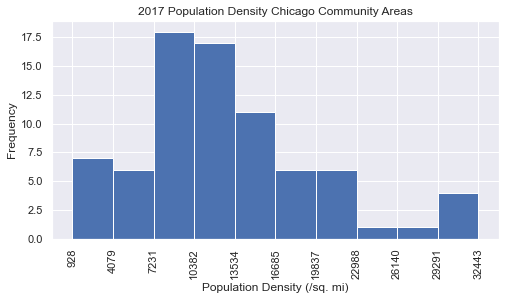

In [94]:
fig, ax = plt.subplots(figsize = (8,4))
n, bins, patches =plt.hist(chicago_data['2017_Population_Density'])
plt.xticks(bins, rotation='vertical')
ax.set_xlabel("Population Density (/sq. mi)")
ax.set_ylabel("Frequency")
ax.set_title("2017 Population Density Chicago Community Areas")
plt.savefig('density.png')
plt.show()

### 2- Crime Rate Visualization

Do you think crime rates are higher where population density is higher? Or, do you think crime rate is the highest in Downtown (The Loop) areas? Let's create a choropleth map of Chicago community areas based on crime rates and observe. 

In [98]:
create_choropleth(column='Crime_Rate',legend='Chicago Crime Rate per 1000 residents')

Based on this map, it appears that Northern Chicago and Southwest Chicago are safer than other regions. The crime rate is highest in West Garfield Park and Fuller Park followed by East Garfield Park, North Lawndale, Englewood, West Englewood, Greater Grand Crossing and Chatham. 

Let's also create a histogram:

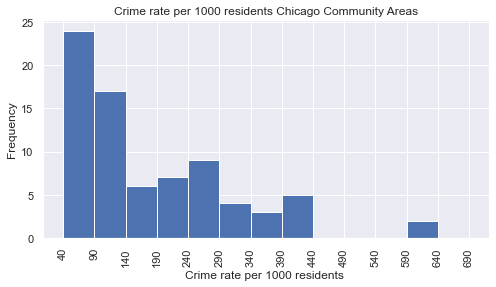

In [100]:
fig, ax = plt.subplots(figsize = (8,4))
n, bins, patches=plt.hist(chicago_data['Crime_Rate'], bins=[i for i in range(40,700,50)])
plt.xticks(bins, rotation='vertical')
ax.set_xlabel("Crime rate per 1000 residents ")
ax.set_ylabel("Frequency")
ax.set_title("Crime rate per 1000 residents Chicago Community Areas")
plt.savefig('crimes.png')
plt.show()

Let's see which community areas have the **lowest crime rates**.

In [101]:
crime_sorted= chicago_data.sort_values(by = 'Crime_Rate') 
crime_sorted[['Community_Name', 'Crime_Rate']].head(10)

,Community_Name,Crime_Rate
8,EDISON PARK,40.068936
73,MOUNT GREENWOOD,46.013384
11,FOREST GLEN,47.794311
9,NORWOOD PARK,53.385101
16,DUNNING,57.291309
4,NORTH CENTER,63.119953
63,CLEARING,64.346684
10,JEFFERSON PARK,66.733811
17,MONTCLARE,75.198843
59,BRIDGEPORT,75.571543


Let's see which community areas have the **highest crime rates.**

In [96]:
crime_sorted= chicago_data.sort_values(by = 'Crime_Rate', ascending=False) 
crime_sorted[['Community_Name', 'Crime_Rate']].head(10)

,Community_Name,Crime_Rate
25,WEST GARFIELD PARK,621.686185
36,FULLER PARK,619.926199
67,ENGLEWOOD,425.044865
28,NORTH LAWNDALE,424.486049
31,LOOP,424.386845
26,EAST GARFIELD PARK,397.979596
66,WEST ENGLEWOOD,391.159076
68,GREATER GRAND CROSSING,377.699427
43,CHATHAM,374.485861
39,WASHINGTON PARK,353.069031


### 3- Median House Price Visulaization

Now, let's create a visuzalization of Median House Prices.

In [102]:
create_choropleth(column='Median_House_Price',legend='$ Median House Price (Single Family Home-Zillow)')

Northeast Chicago had the highest population density. It appears that the median house prices are pretty high in this region. The community areas in the west and south have lower median house prices.

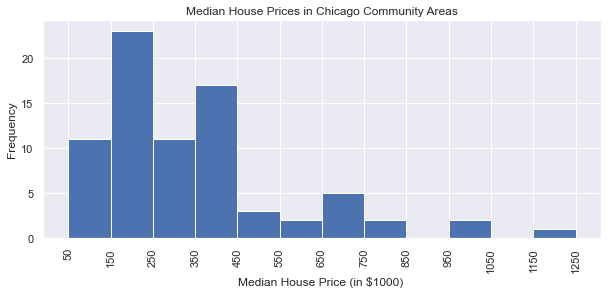

In [108]:
fig, ax = plt.subplots(figsize = (10,4))
n, bins, patches=plt.hist(chicago_data['Median_House_Price']/1000, bins=[i for i in range(50, 1300,100)])
plt.xticks(bins, rotation='vertical')
ax.set_xlabel("Median House Price (in $1000) ")
ax.set_ylabel("Frequency")
ax.set_title("Median House Prices in Chicago Community Areas")
plt.savefig('house.png')
plt.show()

**Let's display the community areas with the lowest median house price:**

In [109]:
house_price_sorted= chicago_data.sort_values(by = 'Median_House_Price') 
house_price_sorted[['Community_Name', 'Median_House_Price']].head(10)

,Community_Name,Median_House_Price
53,RIVERDALE,58036.0
66,WEST ENGLEWOOD,96297.0
50,SOUTH DEERING,116082.0
52,WEST PULLMAN,117172.0
48,ROSELAND,129089.0
36,FULLER PARK,132765.0
68,GREATER GRAND CROSSING,135582.5
45,SOUTH CHICAGO,138913.0
49,PULLMAN,142833.0
54,HEGEWISCH,146297.0


**Let's display the community areas with the highest median house price:**

In [110]:
house_price_sorted= chicago_data.sort_values(by = 'Median_House_Price', ascending=False) 
house_price_sorted[['Community_Name', 'Median_House_Price']].head(10)

,Community_Name,Median_House_Price
6,LINCOLN PARK,1242750.0
4,NORTH CENTER,1032181.5
5,LAKE VIEW,978092.0
7,NEAR NORTH SIDE,809620.0
21,LOGAN SQUARE,750316.5
76,EDGEWATER,744463.0
2,UPTOWN,738394.0
32,NEAR SOUTH SIDE,724763.0
3,LINCOLN SQUARE,719352.0
23,WEST TOWN,692204.5


### 4- School Ranking  Visualization
Now, let's create a visuzalization of school scores. 

In [111]:
create_choropleth(column='Median_School_Score',legend='Median School Score: 5 is the highest score corrresponding to a Level 1+ rank')

Northern Chicago and South West Chicago seem to have higher median school scores although there are some other highly ranked community areas as well.

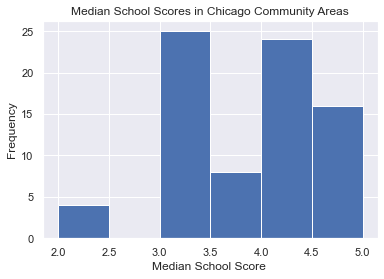

In [112]:
fig, ax = plt.subplots(figsize = (6,4))
plt.hist(chicago_data['Median_School_Score'],bins=6)
ax.set_xlabel("Median School Score ")
ax.set_ylabel("Frequency")
ax.set_title("Median School Scores in Chicago Community Areas")
plt.savefig('school.png')
plt.show()

**Let's display the community areas with the lowest and highest median school scores.**

In [113]:
school_scores_sorted= chicago_data.sort_values(by = 'Median_School_Score') 
school_scores_sorted[['Community_Name', 'Median_School_Score']].head(10)

,Community_Name,Median_School_Score
68,GREATER GRAND CROSSING,2.0
50,SOUTH DEERING,2.0
46,BURNSIDE,2.0
35,OAKLAND,2.0
53,RIVERDALE,3.0
24,AUSTIN,3.0
26,EAST GARFIELD PARK,3.0
27,NEAR WEST SIDE,3.0
28,NORTH LAWNDALE,3.0
49,PULLMAN,3.0


In [114]:
school_scores_sorted= chicago_data.sort_values(by = 'Median_School_Score', ascending=False) 
school_scores_sorted[['Community_Name', 'Median_School_Score']].head(15)

,Community_Name,Median_School_Score
13,ALBANY PARK,5.0
33,ARMOUR SQUARE,5.0
75,OHARE,5.0
3,LINCOLN SQUARE,5.0
4,NORTH CENTER,5.0
5,LAKE VIEW,5.0
73,MOUNT GREENWOOD,5.0
1,WEST RIDGE,5.0
31,LOOP,5.0
59,BRIDGEPORT,5.0


### 5 - Travel Distance Visualization

In [115]:
create_choropleth(column='Travel_Distance_mi',legend='Travel Distance to Downtown Chicago in miles')

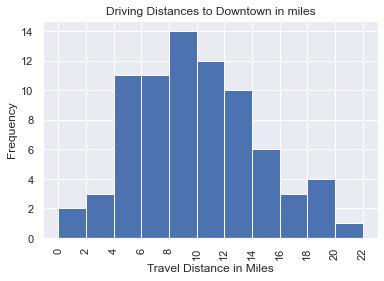

In [116]:
fig, ax = plt.subplots(figsize = (6,4))
n, bins, patches= plt.hist(chicago_data['Travel_Distance_mi'],bins=[i for i in range(0,24,2)])
plt.xticks(bins, rotation='vertical')
ax.set_xlabel("Travel Distance in Miles")
ax.set_ylabel("Frequency")
ax.set_title("Driving Distances to Downtown in miles")
plt.savefig('distance.png')
plt.show()

In [117]:
distance_sorted= chicago_data.sort_values(by = 'Travel_Distance_mi') 
distance_sorted[['Community_Name', 'Travel_Distance_mi']].head(10)

,Community_Name,Travel_Distance_mi
31,LOOP,0.889803
32,NEAR SOUTH SIDE,1.537893
7,NEAR NORTH SIDE,2.241907
27,NEAR WEST SIDE,2.518417
30,LOWER WEST SIDE,3.644962
33,ARMOUR SQUARE,4.297402
35,OAKLAND,4.382530
26,EAST GARFIELD PARK,4.537872
34,DOUGLAS,4.925608
59,BRIDGEPORT,5.107670


### 5 - Number of Parks Visualization¶

There are many venues under the park category in Foursquare such as playgrounds, soccer fields, bike trails etc. 

In [118]:
create_choropleth(column='Num_of_Parks',legend='Number of parks within 1000 m')

Looking at the visualization, the community area with the greatest number of parks (48) is the Loop, which is a portion of DownTown Chicago. 48 parks in a relatively smaller area seems a bit suspicious. Let's take a look into venue names in this region.

In [119]:
Park_ID='4bf58dd8d48988d163941735' 
Park_radius=1000
# Latitude longitude of the Loop
lat='41.8816094'
lng='-87.6294574'
url = 'https://api.foursquare.com/v2/venues/search?categoryId={}&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}'.format(
    Park_ID,
    CLIENT_ID, 
    CLIENT_SECRET, 
    VERSION, 
    lat, 
    lng, 
    Park_radius, 
    LIMIT)
results = requests.get(url).json()["response"]
df=pd.DataFrame(results['venues'])


In [127]:
df.loc[[i for i in range(24,33,1)],'name']

24                          Wanderlust Yoga in the City
25                                         Mailman Park
26                               We Want A Park Protest
27                          Union Station Secret Garden
28                                        Dearborn Park
29                                        Pritzker Park
30                                          Cafe Liquid
31                         Wills Grassy Slice Of Heaven
32    Point du Sable and John Frontage historic meet...
Name: name, dtype: object

In [121]:
for i in range(df.shape[0]):
    if df['categories'][i][0]['name']!='Park':
        print(df['categories'][i][0]['name'])

Plaza
Botanical Garden
Botanical Garden
Garden
Monument / Landmark
Office
Café
Baseball Field
Plaza
Other Great Outdoors


It appears that searching by Park venue category id included some venues such as cafe, office, etc.


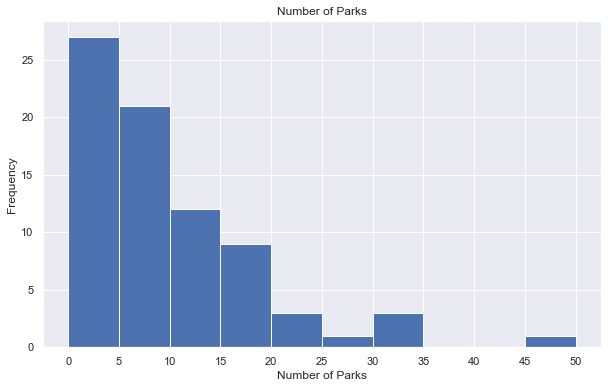

In [128]:
fig, ax = plt.subplots(figsize = (10,6))
n, bins, sacks=plt.hist(chicago_data['Num_of_Parks'],bins=[i for i in range(0,55,5)])
plt.xticks(bins)
ax.set_xlabel("Number of Parks")
ax.set_ylabel("Frequency")
ax.set_title("Number of Parks")
plt.savefig('parks.png')
plt.show()

In [129]:
parks_sorted= chicago_data.sort_values(by = 'Num_of_Parks') 
parks_sorted[['Community_Name', 'Num_of_Parks']].head(10)

,Community_Name,Num_of_Parks
50,SOUTH DEERING,0
75,OHARE,0
53,RIVERDALE,1
47,CALUMET HEIGHTS,1
64,WEST LAWN,1
48,ROSELAND,2
57,BRIGHTON PARK,2
63,CLEARING,2
18,BELMONT CRAGIN,2
61,WEST ELSDON,2


### 6 - Number of Martial Arts Schools (Dojo) Visualization¶



In [130]:
create_choropleth(column='Num_of_Martial_Arts',legend='Number of martial art schools within 2000 m')

The community areas in the Northern side have more martial arts schools.

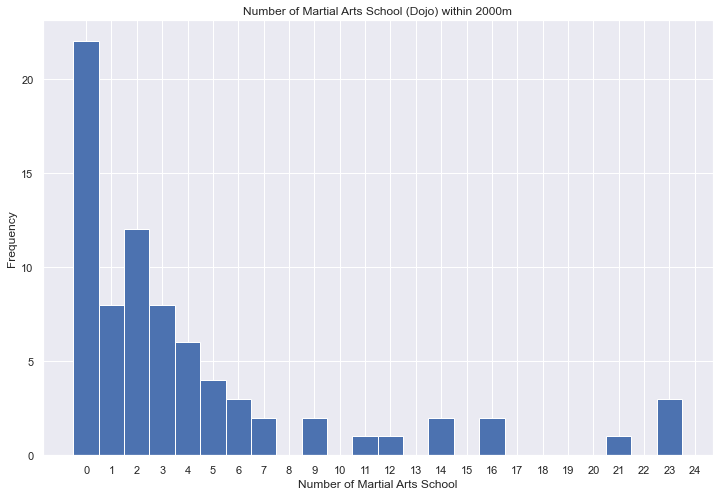

In [131]:
fig, ax = plt.subplots(figsize = (12,8))
n, bins, sacks=plt.hist(chicago_data['Num_of_Martial_Arts'],bins=[i for i in range(0,25,1)],align='left')
plt.xticks(bins)
ax.set_xlabel("Number of Martial Arts School")
ax.set_ylabel("Frequency")
ax.set_title("Number of Martial Arts School (Dojo) within 2000m")
plt.savefig('martial.png')
plt.show()

### 6 - Number of Music Schools Visualization¶

In [132]:
create_choropleth(column='Num_of_Music_School',legend='Number of music schools within 2000 m')

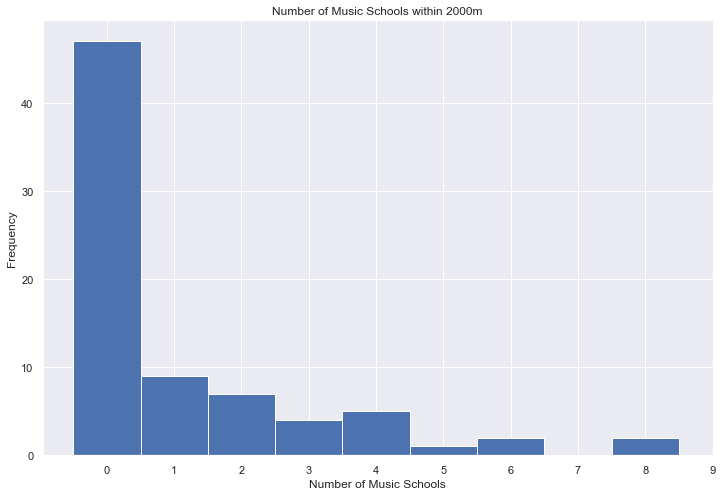

In [133]:
fig, ax = plt.subplots(figsize = (12,8))
n, bins, sacks=plt.hist(chicago_data['Num_of_Music_School'],bins=[i for i in range(0,10,1)],align='left')
plt.xticks(bins)
ax.set_xlabel("Number of Music Schools")
ax.set_ylabel("Frequency")
ax.set_title("Number of Music Schools within 2000m")
plt.savefig('music.png')
plt.show()

In [12]:
features=chicago_data[['Crime_Rate', 'Median_House_Price', 'Median_School_Score','Travel_Distance_mi','Num_of_Parks', 'Num_of_Martial_Arts','Num_of_Music_School']]

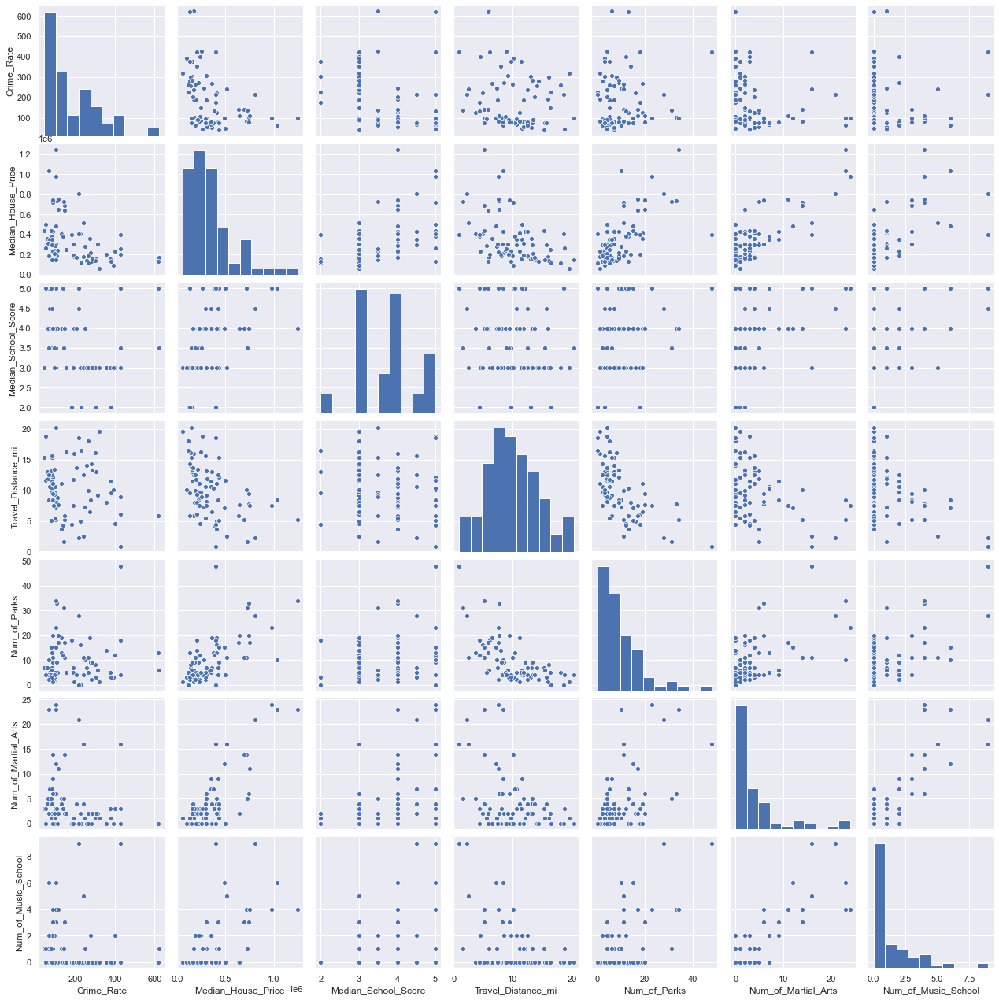

In [135]:
sns.pairplot(features)

The pairplot from seaborn library allows us to observe the scatterplots for each pair of features. From the scatterplots, there appears to be a positive linear relation between number of martial arts schools and music schools. There is a negative relation between number of parks and travel distance to Downtown Chicago. This sounds a bit counter intuitive at first, but considering the wide range of venues included in 'Park' category by Foursquare it looks reasonable. The relation between median house price and travel distance is a negative one although not strongly correlated.

Let's also calculate the correlation between pairs of features and display with a background gradient:

In [136]:
features.corr().style.background_gradient(cmap='Blues')

,Crime_Rate,Median_House_Price,Median_School_Score,Travel_Distance_mi,Num_of_Parks,Num_of_Martial_Arts,Num_of_Music_School
Crime_Rate,1.000000,-0.387826,-0.362126,-0.164451,0.079803,-0.210182,-0.090776
Median_House_Price,-0.387826,1.000000,0.469468,-0.455463,0.637306,0.788938,0.615941
Median_School_Score,-0.362126,0.469468,1.000000,-0.136103,0.246884,0.407231,0.320779
Travel_Distance_mi,-0.164451,-0.455463,-0.136103,1.000000,-0.634420,-0.388482,-0.429961
Num_of_Parks,0.079803,0.637306,0.246884,-0.634420,1.000000,0.544004,0.577998
Num_of_Martial_Arts,-0.210182,0.788938,0.407231,-0.388482,0.544004,1.000000,0.826512
Num_of_Music_School,-0.090776,0.615941,0.320779,-0.429961,0.577998,0.826512,1.000000


## 4 - Clustering <a name="cluster"></a>

Before clustering our data let's try to come up with a suggestion based on some heuristic rules. For instance, let's find out which community areas match the following criteria:

 1- median house price is less than $700,000
 
 2- crime rate less than 230 (per 1000 residents condisering total number of crimes in since 2019
 
 3- median school score is greater than or equal to 4
 
 4- more than 2 parks
 
 5- at least one music school and one martial arts school
 
 6- driving distance less than 11 miles
 
We'll go step by step to see how many features are filtered at each step:

**Rule(filtering) Based Solution**

In [67]:
features_filtered=features.loc[features['Median_House_Price']<700000]
features_filtered.shape

(68, 7)

In [68]:
features_filtered2=features_filtered.loc[features_filtered['Crime_Rate']<230]
features_filtered2.shape

(44, 7)

In [69]:
features_filtered3=features_filtered2.loc[features_filtered2['Median_School_Score']>=4]
features_filtered3.shape

(29, 7)

In [70]:
features_filtered4=features_filtered3.loc[features_filtered3['Num_of_Parks']>=2]
features_filtered4.shape

(26, 7)

In [71]:
features_filtered5=features_filtered4.loc[features_filtered4['Num_of_Martial_Arts']>=1]
features_filtered5.shape

(23, 7)

In [72]:
features_filtered6=features_filtered5.loc[features_filtered5['Num_of_Music_School']>=1]
features_filtered6.shape

(10, 7)

In [73]:
features_filtered7=features_filtered6.loc[features_filtered6['Travel_Distance_mi']<11]
features_filtered7.shape

(4, 7)

In [74]:
features_filtered7

,Crime_Rate,Median_House_Price,Median_School_Score,Travel_Distance_mi,Num_of_Parks,Num_of_Martial_Arts,Num_of_Music_School
10,66.733811,351732.5,4.5,10.577599,5,7,2
15,81.749258,427607.0,4.0,8.379809,4,9,3
20,99.764504,486231.0,4.0,7.187398,15,12,6
23,141.617950,692204.5,4.0,5.214545,11,14,3


We were able to filter down to 4 community areas. Let's get the community area names:

In [78]:
filtered_result=chicago_data.loc[[10,15,20,23],['Community_Number','Community_Name','Crime_Rate','Median_House_Price','Median_School_Score','Travel_Distance_mi','Num_of_Parks','Num_of_Martial_Arts','Num_of_Music_School']]
filtered_result

,Community_Number,Community_Name,Crime_Rate,Median_House_Price,Median_School_Score,Travel_Distance_mi,Num_of_Parks,Num_of_Martial_Arts,Num_of_Music_School
10,11,JEFFERSON PARK,66.733811,351732.5,4.5,10.577599,5,7,2
15,16,IRVING PARK,81.749258,427607.0,4.0,8.379809,4,9,3
20,21,AVONDALE,99.764504,486231.0,4.0,7.187398,15,12,6
23,24,WEST TOWN,141.617950,692204.5,4.0,5.214545,11,14,3


**This list of community areas accompanied by all the visualizations we created are valueable information for the family. We'd like to also cluster our community areas to observe relations in between clusters. This will provide the family more information when comparing community areas** 

### KMeans Clustering

Let's cluster our community areas using KMeans clustering.

We'll first write a function that iterates through different values of K and outputs curves used for the selection of optimal K based on the elbow method and the sillhouette score.

In [16]:
def find_K(X, maxK):
    inertias = [] 
    scores=[]
    K = range(1,maxK+1) 
  
    for k in K: 
        KM = KMeans(n_clusters=k, random_state=0).fit(X) 
        inertias.append(KM.inertia_) 
        if k>1:
            scores.append(silhouette_score(X, KM.predict(X)))

    fig, (ax1, ax2) = plt.subplots(2,1,figsize=(8, 8),sharex=True)

    ax1.plot(K, inertias, 'bx-') 
    ax1.set( ylabel='Inertia')
    ax1.set_title('The Elbow Method using Inertia and The Silhouette Method ')

    ax2.plot([i for i in K if i>1],scores,'bx-') 
    ax2.set(xlabel='K', ylabel='Silhouette Score')
    #ax2.set_title('Silhouette Score vs Values of K')
    fig.tight_layout() 
    plt.show()

We'll scale our data. Based on seaborn pairplot, all our features except for the travel Distance seem to be skewed. 
We'll take the logarithm of these features and then scale them. However, if a value is 0, the logarithm is undefined. Thus, we'll increase values by 1 before taking the logarithm for features with 0 entries.


In [14]:
Scaler= StandardScaler()
LX=features.copy()
LX['Crime_Rate']=np.log(LX['Crime_Rate'])
LX['Median_House_Price']=np.log(LX['Median_House_Price'])
LX['Num_of_Parks']=np.log(LX['Num_of_Parks']+1)
LX['Num_of_Martial_Arts']=np.log(LX['Num_of_Martial_Arts']+1)
LX['Num_of_Music_School']=np.log(LX['Num_of_Music_School']+1)
LX.head()

,Crime_Rate,Median_House_Price,Median_School_Score,Travel_Distance_mi,Num_of_Parks,Num_of_Martial_Arts,Num_of_Music_School
0,4.838325,12.925959,4.0,11.159202,2.995732,1.609438,0.693147
1,4.396647,12.969995,5.0,12.074481,2.302585,0.693147,0.693147
2,4.633352,13.512233,4.0,7.733583,3.526361,1.945910,1.609438
3,4.417585,13.486106,5.0,10.029549,2.484907,2.708050,1.609438
4,4.145037,13.847185,5.0,8.399693,2.397895,3.178054,1.945910


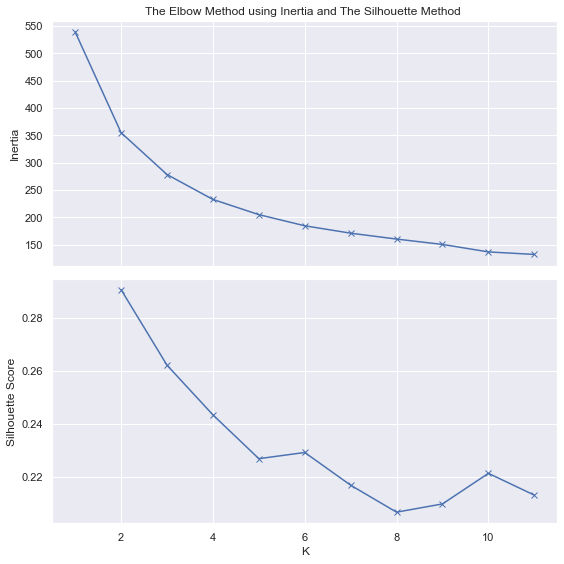

In [17]:
Z=Scaler.fit(LX).transform(LX)
find_K(Z,11)

If we use all the features at once, the optimal K is 2. Thus, we'll use the primary features to get our primary clusters and then use the secondary features on the primary clusters to cluster all community areaa.

In [13]:
Primary_Features=['Crime_Rate', 'Median_House_Price','Median_School_Score']
Secondary_Features=['Num_of_Parks','Num_of_Martial_Arts','Num_of_Music_School','Travel_Distance_mi']


We'll first form our clusters by using our primary features. Then we'll further cluster using secondary features.

In [18]:
LX_P=LX[Primary_Features]
LX_S=LX[Secondary_Features]
Scaler.fit(LX_P)
ZP=Scaler.transform(LX_P)
Scaler.fit(LX_S)

StandardScaler()

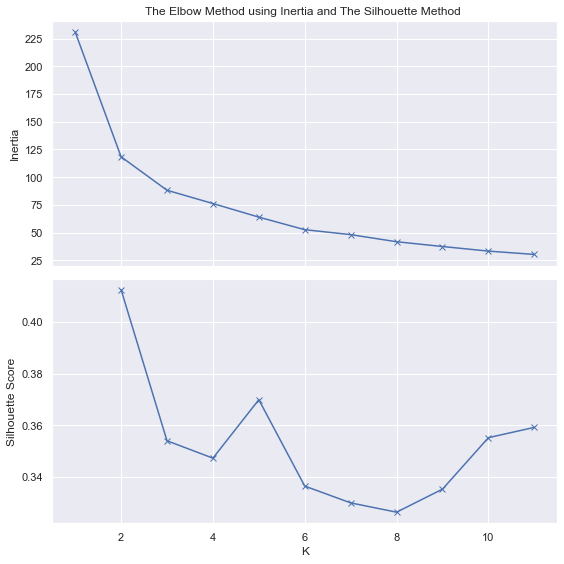

In [19]:
find_K(ZP,11)

K=2 according to both the Elbow method and the Silhouette score method. In the elbow method, we are looking for the elbow. Sometimes, it is hard to decide where it is exactly. In the Silhouette score method, we are looking for the K at which we get maximum silhouette score. Although the score is not that good, it is still the highest at K=2.

We'll cluster our data set using K=2 and primary features. Each group formed will be further clustered.

In [20]:
kmeanModel=KMeans(n_clusters=2, random_state=0).fit(ZP) 
primary_labels=kmeanModel.labels_
primary_cluster_centers=kmeanModel.cluster_centers_
group1_index = np.where(primary_labels == 0)[0]
group2_index = np.where(primary_labels == 1)[0]

In [21]:
group1_index

array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
       17, 18, 20, 21, 23, 29, 30, 31, 32, 33, 38, 40, 56, 57, 58, 59, 61,
       62, 63, 64, 71, 73, 75, 76])

In [22]:
group2_index

array([19, 22, 24, 25, 26, 27, 28, 34, 35, 36, 37, 39, 41, 42, 43, 44, 45,
       46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 60, 65, 66, 67, 68, 69, 70,
       72, 74])

**After defining group 1 and group 2, we'll scale the secondary features and run KMeans on both groups**

In [23]:
G1=LX.loc[group1_index]
G2=LX.loc[group2_index]

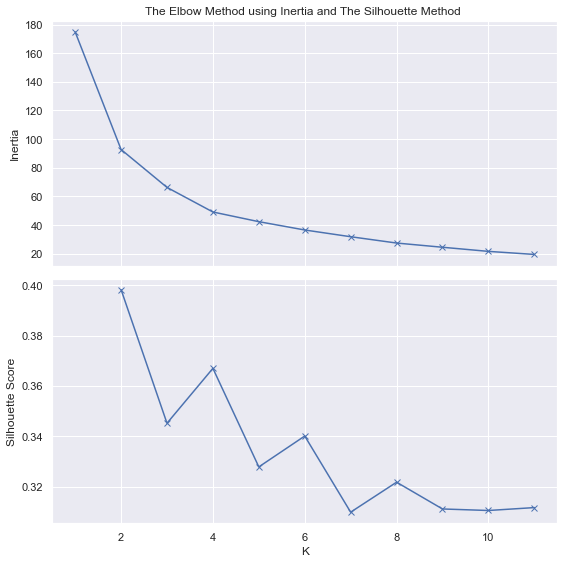

In [24]:
X1=Scaler.transform(G1[Secondary_Features])
find_K(X1,11)

Based on the above plots we choose K=2 for group 1.

In [25]:
KM1=KMeans(n_clusters=2, random_state=0).fit(X1) 
G1_labels=KM1.labels_
G1_cluster_centers=KM1.cluster_centers_
G1_1_index = np.where(G1_labels == 0)[0]
G1_2_index = np.where(G1_labels == 1)[0]

In [26]:
G1_1_index 

array([ 0,  1,  8,  9, 10, 11, 12, 13, 14, 16, 17, 18, 22, 23, 26, 27, 28,
       29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39])

In [27]:
G1_2_index 

array([ 2,  3,  4,  5,  6,  7, 15, 19, 20, 21, 24, 25, 40])

Returned indices are based on the input matrix. We need to find the corresponding indices in our original input matrix.

In [28]:
C11_index=[group1_index[i] for i in G1_1_index]
C12_index=[group1_index[i] for i in G1_2_index]

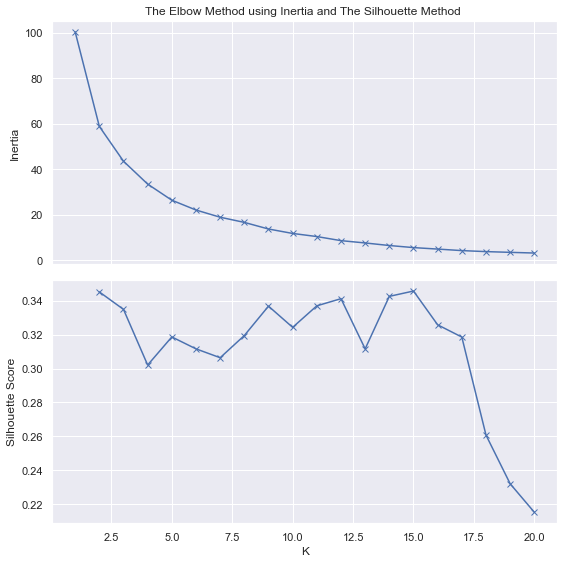

In [29]:
X2=Scaler.transform(G2[Secondary_Features])
find_K(X2,20)

Based on the above plots we choose K=2 for group 2 as well. We observe a silhouette peak at K=11. However the score for K=2 is pretty close to it.

In [30]:
KM2=KMeans(n_clusters=2, random_state=0).fit(X2) 
G2_labels=KM2.labels_
G2_cluster_centers=KM2.cluster_centers_
G2_1_index = np.where(G2_labels == 0)[0]
G2_2_index = np.where(G2_labels == 1)[0]

In [31]:
group2_index

array([19, 22, 24, 25, 26, 27, 28, 34, 35, 36, 37, 39, 41, 42, 43, 44, 45,
       46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 60, 65, 66, 67, 68, 69, 70,
       72, 74])

In [32]:
G2_1_index

array([14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 28, 29, 30, 31, 32,
       33, 34, 35])

We have 4 clusters each represented by the indices at G1_1_index, G1_2_index,G2_1_index,G2_1_index

In [33]:
C21_index=[group2_index[i] for i in G2_1_index]
C22_index=[group2_index[i] for i in G2_2_index]

In [34]:
G1_1=chicago_data.loc[C11_index]
G1_2=chicago_data.loc[C12_index]
G2_1=chicago_data.loc[C21_index]
G2_2=chicago_data.loc[C22_index]

In [35]:
chicago_data['Cluster']=pd.Series()
chicago_data.head()

<ipython-input-35-23698dc7bc22>:1: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  chicago_data['Cluster']=pd.Series()


,Community_Number,Community_Name,2017_Population,2017_Population_Density,Latitude,Longitude,Number_of_Crimes,Median_House_Price,Median_School_Score,Num_of_Parks,Num_of_Martial_Arts,Num_of_Music_School,Travel_Distance_mi,Crime_Rate,Cluster
0,1,ROGERS PARK,55062,29925.00,42.010531,-87.670748,6952,410840.0,4.0,19,4,1,11.159202,126.257673,NaN
1,2,WEST RIDGE,76215,21590.65,42.003548,-87.696243,6187,429336.0,5.0,9,1,1,12.074481,81.178246,NaN
2,3,UPTOWN,57973,24988.36,41.966630,-87.655546,5963,738394.0,4.0,33,6,4,7.733583,102.858227,NaN
3,4,LINCOLN SQUARE,41715,16294.92,41.975990,-87.689616,3458,719352.0,5.0,11,14,4,10.029549,82.895841,NaN
4,5,NORTH CENTER,35789,17458.05,41.956107,-87.679160,2259,1032181.5,5.0,10,23,6,8.399693,63.119953,NaN


In [36]:
chicago_data.loc[C11_index,'Cluster']= 1
chicago_data.loc[C12_index,'Cluster']= 2
chicago_data.loc[C21_index,'Cluster']= 3
chicago_data.loc[C22_index,'Cluster']= 4

In [38]:
print('The sizes of clusters 1, 2, 3, 4:', len(G1_1_index), len(G1_2_index), len(G2_1_index),len(G2_2_index))

The sizes of clusters 1, 2, 3, 4: 28 13 20 16


In [122]:
chicago_data.head()

,Community_Number,Community_Name,2017_Population,2017_Population_Density,Latitude,Longitude,Number_of_Crimes,Median_House_Price,Median_School_Score,Num_of_Parks,Num_of_Martial_Arts,Num_of_Music_School,Travel_Distance_mi,Crime_Rate,Cluster
0,1,ROGERS PARK,55062,29925.00,42.010531,-87.670748,6952,410840.0,4.0,19,4,1,11.159202,126.257673,1.0
1,2,WEST RIDGE,76215,21590.65,42.003548,-87.696243,6187,429336.0,5.0,9,1,1,12.074481,81.178246,1.0
2,3,UPTOWN,57973,24988.36,41.966630,-87.655546,5963,738394.0,4.0,33,6,4,7.733583,102.858227,2.0
3,4,LINCOLN SQUARE,41715,16294.92,41.975990,-87.689616,3458,719352.0,5.0,11,14,4,10.029549,82.895841,2.0
4,5,NORTH CENTER,35789,17458.05,41.956107,-87.679160,2259,1032181.5,5.0,10,23,6,8.399693,63.119953,2.0


In [183]:
create_choropleth(column='Cluster', legend='4 clusters of Chicago community areas')

Each color in the choropleth represents a Kmeans cluster. An interpretation of these clusters is available in the Results and Discussion section.

### 5 - Results and Discussion <a name="results"></a>

Based on our analysis, we can suggest the family some community areas to move to.

First of all, based on the following criteria:

1. median house price is less than \\$700,000 dollars
2. crime rate less than 230 (per 1000 residents condisering total number of crimes in since 2019)
3. median school score is greater than or equal to 4
4. more than 2 parks
5. at least one music school and one martial arts school
6. driving distance less than 11 miles

we filtered our dataframe and came up with a list of suggestions:

In [79]:
filtered_result

,Community_Number,Community_Name,Crime_Rate,Median_House_Price,Median_School_Score,Travel_Distance_mi,Num_of_Parks,Num_of_Martial_Arts,Num_of_Music_School
10,11,JEFFERSON PARK,66.733811,351732.5,4.5,10.577599,5,7,2
15,16,IRVING PARK,81.749258,427607.0,4.0,8.379809,4,9,3
20,21,AVONDALE,99.764504,486231.0,4.0,7.187398,15,12,6
23,24,WEST TOWN,141.617950,692204.5,4.0,5.214545,11,14,3


Jefferson Park seems to be a good choice for the family. Among the other community areas in this list, it has the lowest crime rate, the lowest median house price, and the highest median school score. There are also enough number of venues of interest. The only downside is the longer driving distance.  West Town is the closest to Downtown, however both the crime rate and the house prices are highest within this group. 



We created four clusters of Chicago Community areas using KMeans. First, we grouped the features into primary and secondary. Primary features are crime rate, median house price and median school score. Secondary features are travel distance to Downtown, number of parks within 1km, number of martial arts schools within 2km, and number of music schools within 2km. We obtained two clusters using the primary features and then 2 subclusters for each cluster using the secondary features.

**Let's create a choropleth map using cluster colors and all the feature information to the labels.**

In [118]:
# Chicago latitude and longitude values
latitude = 41.89647
longitude = -87.635719
CH_geo = r'Boundaries_Chicago.geojson' # geojson file
zoom_start=10.5
CH_map = folium.Map(location=[latitude, longitude], zoom_start=zoom_start)

    # generate choropleth map using the population density of community area
CH_map.choropleth(
    geo_data=CH_geo,
    data=chicago_data[['Community_Name','Cluster']],
    columns=['Community_Name', 'Cluster'],
    key_on='feature.properties.community',
    fill_color='YlOrRd', 
    fill_opacity=0.7, 
    line_opacity=0.2,
    legend_name="Chicago community area clusters"
) 

# add markers to map
for lat, lng, community, c, h, s, d, p, ma, mu in zip(chicago_data['Latitude'],chicago_data['Longitude'],\
                                                      chicago_data['Community_Name'],chicago_data['Crime_Rate'],chicago_data['Median_House_Price'],\
                                                      chicago_data['Median_School_Score'], chicago_data['Travel_Distance_mi'],\
                                                      chicago_data['Num_of_Parks'], chicago_data['Num_of_Martial_Arts'],chicago_data['Num_of_Music_School'] ):
    label1 = community + ','+' Crime Rate: {:.2f},'.format(c)+" Median House Price in 1K: ${:.2f},".format(h/1000)
    label1+=" Median School Score : {:.1f},".format(s)+" Driving distance to Downtown (mi): {:.2f},".format(d)
    label1+= " Number of parks: {},".format(p)+" Number of Martial Arts Dojo: {},".format(ma)+" Number of music schools: {}".format(mu)
    label = folium.Popup(label1, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=5,
        popup=label,
        color='blue',
        fill=True,
        fill_color='#3186cc',
        fill_opacity=0.7,
        parse_html=False).add_to(CH_map)  

CH_map


The family can use the above map to compare community areas. 

The crime rate is calculated by adding all crime incidents reported in the community area since the beginning of 2019 until November 28, 2020 and then dividing that number by the community area population in 1000 so that we get a rate per 1000 residents. 

The median school score is the median score of the schools within a community area. However, enrollment in public schools is adress based and family should check which schools cover their candidate adress. A score of 5 is highest and corresponds to **Level 1+** based on CPS school quality ranking. CPS uses several metrics when determining school rankings. We refer the reader to CPS (Chicago Public Schools) website for further information on the metrics.

The median house prices are single family house prices as of October 31, 2020. Since this data is available in Zillow at the neighborhood area level, we took the median of the prices of the neighborhoods to come up with an estimate for the community area median house price. 77 community areas in Chicago are officially recognized. However, neighborhood area names are not official and are not consistent across different sources. For instance 200 neighborhoods are listed in Zillow whereas Wikipedia lists 245 neighborhoods. 

**Yellow cluster (1):** 
- These community areas in general have lower crime rates (most are below 100 and all are below 145 per 1000 residents).
- The median house prices are below \\$450000 except for the two community areas in the shore wih prices in the \\$640,000 (Kenwood and Hyde Park). 
- The median school scores are mostly at or above 4 with a few exceptions of 3.5 (Gage Park, Clearing)
- Either the number of music schools or martial arts dojos within 2km is 0 or 1. (Jefferson Park and Portage Park are exeptions )

**Orange cluster (2):**

- These community areas in general have lower crime rates (most are below 120 and the exceptions are the community areas very close to Downtown such as Loop (424.64) and Near North Side (214.99) ) 
- The median house prices start at \\$400K and goes as high as $1200K. The community areas in the north west region of this cluster, Irving Park and Avondale, have the lowest house prices in this cluster.
- The median school scores are all at or above 4 with only one exception of 3.5 (Near South Side)
- Parks, music schools, and martial arts dojos are abundunt in these community areas.

**Dark orange cluster (3):**

- The community areas in the northern part of this cluster have pretty high crime rates (Englewood: 425, Greater Grand Crossing: 378). The other community areas in this cluster have crime rates around 200 and above. The only exceptions are East Side (77.73) and  Ashburn (90.95). 
- The median house prices are the lowest in the city as most of them are under \\$150K. Only exception is Englewood with a median house price of \\$255K.
- The median school scores are all at or below 3 with only two exceptions of 3.5 (Englewood and Eastside)
- Although these community areas have some parks, none has music schools within 2km distance. Few of them have martial arts schools.

**Darkest cluster (4):**

- Crime rates are pretty high in this cluster as most community areas have rates above 200. Hermosa and Garfield Ridge are the safest community areas in this cluster with crime rates below 100.
- Median house prices are close to \\$200K and above going as high as \\$500K.
- The median school scores are 3 or below except for Humboldt Park (4) and West Garfield Park (3).
- The community areas in this cluster at the top side have in general good number of parks, music schools and martial art dojos. The southern parts of the cluster lacks those venue types except for the parks.



Based on this analysis **the community areas in the Orange Cluster (2) are the best if the family can afford it.** Especially **Irving Park** and **Avondale** can be good choices as they have lower house prices. **The second best cluster is the Yellow Cluster (1).** The family can especially consider **the community areas in this cluster that are at the boundary of the Orange Cluster.** 

When we filtered our data based on the criteria listed at the beginning of this section, we came up with with 4 community areas. From that list Irving Park, Avondale, and West Town belong to the Orange Cluster. Jefferson Park belongs to the Yellow Cluster (1) and it is close to Irving Park in the Orange Cluster (2).



## 6- Conclusion <a name="conclusion"></a>

We collected and combined data from several sources. Exploring data sources, using web scraping and APIs to get our data formed the major part of this project.

In the Explatory data analysis part, we especially relied on Choropleth maps using Folium. Folium and Choropleth are amazing visualization tools that helped us make important observations about how crime rates, school rankings, house prices vary accross Chicago. 

Although we specificly looked into the preferences of one family, the results of this project are valuable to any person who is considering to move to Chicago and people/stakeholders who would want to know more about Chicago community areas for other purposes including city/business planning.

We shortlisted some community areas for the family that match their preferences. In addition, we are providing a map of community areas displaying clusters as well as community area specific features via labels on the map. This map is a great visual resource to compare community areas.

For clustering, we categorized our features as primary and secondary. Primary features are the ones that are more important such as crime rate, median house price, and school ranking. We first clustered the community areas into two based on primary features. Next, we further clustered the initial clusters using secondary features. We determined the optimal K in Kmeans by plotting the silhouette score as well as the elbow method. We also normalized and scaled our features (for the features with skewed distributions, we took the logarithm first to normalize and then apllied standard scaler to come up with the z scores).

We were able to interpret the meaning of the clusters we obtained by Kmeans. Often times, interpretation part is the hardest part of clustering. When you run any clustering algorithm with any set of compatible features, you will get clusters. However, those clusters may not have any meaning. Since there are no labels to compare to, it is really hard to know how good your clusters are. One may argue that we have metrics such as silhouette score, inertia, distortion to tell how good the clusters are but the point is in terms of how relavant the clusters are to the problem. Feature selection and scaling are important contributers to the succes of the method as well.  

Possible future work involves adding more features such as most popular venue types, crime trends, house price trends, etc. In addition, this project had given me the opportunity to find out many great data sources and so many ideas for new projects.
